# Summary

In [11]:
from datetime import datetime
import pickle

import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import plotly
import plotly.colors as pc
import plotly.graph_objects as go
import scipy.stats as stats
import torch
import yaml

from price_forecasting.config import MODELS_DIR, PROCESSED_DATA_DIR
from price_forecasting.utils.scoring_tools import get_mean_crps
import price_forecasting.models.normal_skew as model


## Loading Data

In [12]:
#MODEL_DIR = MODELS_DIR / 'normalSkew_v3'
MODEL_DIR = MODELS_DIR / 'normalSkew_tuning'
BASELINE_MODEL_DIR = MODELS_DIR / 'LSTM_v1'

model_label = "Prob Dist"

In [13]:

# load config file and variables from model run
with open(MODEL_DIR / 'config.yaml', 'r') as f:
    config = yaml.safe_load(f)
DATA_SOURCE = PROCESSED_DATA_DIR / config['data_source']

# load X data in DataFrame format
X_test = pd.read_parquet(DATA_SOURCE / 'X_test.pqt')[288:]

# load y_test data and format as numpy array
y_test = pd.read_parquet(DATA_SOURCE / 'y_test.pqt').to_numpy()
y_test = y_test.reshape([-1])[288:]

# load y predictions from model
with np.load(MODEL_DIR / 'y_pred.npz') as f:
    y_pred_params = dict(f)

# baseline predictions loading
y_pred_baseline = np.load(BASELINE_MODEL_DIR / 'y_pred.npy')[288:]

with open(MODEL_DIR / "y_scaler.pkl", 'rb') as f:
    y_scaler = pickle.load(f)

dam = X_test['DAM_PRC'] #day ahead price data

time = X_test.index
time = time.tz_convert('US/Pacific')

In [14]:
#quantiles = [0.001, 0.005, 0.01, 0.05, 0.1, 0.25, 0.5, 0.75, 0.9, 0.95, 0.99, 0.995, 0.999]
quantiles = [0.05, 0.1, 0.25, 0.5, 0.75, 0.9, 0.95]
quantiles = np.array(quantiles)

loc = y_pred_params['loc'].reshape(-1, 1)
scale = y_pred_params['scale'].reshape(-1, 1)
skew = y_pred_params['skew'].reshape(-1, 1)
tailweight = y_pred_params['tailweight'].reshape(-1, 1)

y_pred = stats.norm.ppf(quantiles, loc=loc, scale=scale)
transform = model.SinhArcsinhTransform(skew=skew, tailweight=tailweight)
y_pred = transform(torch.from_numpy(y_pred))
y_pred = y_pred.reshape((-1, len(quantiles)))
y_pred = y_scaler.inverse_transform(y_pred)

#N_mix = y_pred_params["weight"].shape[-1]
#weight = torch.from_numpy(y_pred_params["weight"]).reshape((-1, N_mix))
#df = torch.from_numpy(y_pred_params["df"]).reshape((-1, N_mix))
#loc = torch.from_numpy(y_pred_params["loc"]).reshape((-1, N_mix))
#scale = torch.from_numpy(y_pred_params["scale"]).reshape((-1, N_mix))
#
#y_dist = MixtureSameFamily(
#    Categorical(probs=weight),
#    StudentT(df=df, loc=loc, scale=scale)
#)
#
#samples = y_dist.sample((2000,))

## Plotting

In [15]:
plotly.offline.init_notebook_mode()

def quantile_plot():
    fig = go.Figure()

    n = len(quantiles)
    colors = pc.sample_colorscale('Viridis', [i/n for i in range(n)])

    for i, yi in enumerate(y_pred.T):
        if i == 0: 
            fill = None
        else:
            fill = 'tonexty'
        fig.add_trace(go.Scatter(x=time, y=yi + dam, mode='lines', name=quantiles[i], 
                                 line=dict(width=1,color=colors[i]), fill=fill))

    fig.add_trace(go.Scatter(x=time, y=y_test + dam, mode='lines', name='RTM Price',
                              line=dict(width=2, color='black', dash='dot')))

    fig.add_trace(go.Scatter(x=time, y=dam, mode='lines', name='DAM Price',
                              line=dict(width=2, color='black')))

    start = datetime.fromisoformat('2025-03-01 00:00:00')
    end = datetime.fromisoformat('2025-03-08 00:00:00')

    fig.update_layout(title='SP15 RTM Price Prediction',
                      xaxis_title='Time',
                      width=1100, 
                      height=500,
                      yaxis_title='Price ($/MWh)',
                      xaxis=dict(range=[start, end]),   
                      yaxis=dict(range=[-100, 250]), 
                     )

    fig.show()

quantile_plot()

## Model Quantification

### CRPS

In [16]:
crps = get_mean_crps(y_pred, y_test, quantiles)
print(f"CRPS: {crps:.{3}}")

CRPS: 12.4


### Coverage

In [17]:
fig = go.Figure()

def coverage_calibration_plot(y_pred, label, fig):
    coverage = []
    for i, q in enumerate(quantiles):
        below = (y_test <= y_pred[:,i]).mean()
        coverage.append(below)

    #val = np.subtract(coverage, quantiles)
    val = np.subtract(quantiles, coverage)
    fig.add_trace(go.Scatter(x=quantiles, y=val, mode="markers", name=label,
                              marker=dict(size=8)))


coverage_calibration_plot(y_pred, model_label, fig)
#coverage_calibration_plot(y_pred_baseline, "Baseline", fig)

fig.add_trace(go.Scatter(x=[0,1], y=[0,0], mode='lines', name='Expected',
                          line=dict(width=2, color='black', dash='dot')))

fig.update_layout(title='Coverage Calibration',
                 xaxis_title='Quantile',
                 width=650, 
                 height=500,
                 yaxis_title='Coverage Bias',
                 yaxis=dict(range=[-0.05, 0.05]), 
                 xaxis=dict(range=[0.0, 1.0]), 
                )
fig.show()

### Probability Integral Transform


2.1478755148578754


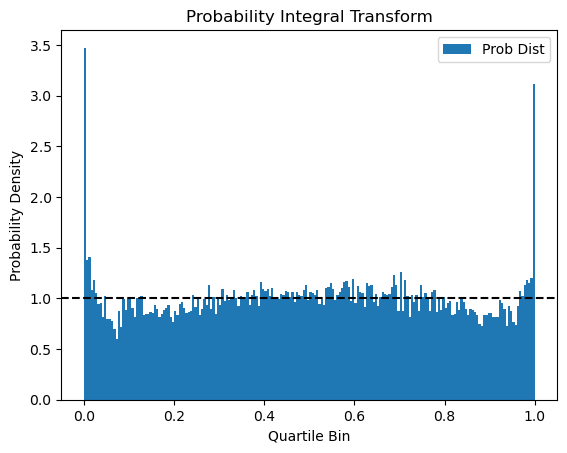

In [18]:

import scipy.stats as stats

def PIT_plot(y_pred, label, alpha=1):
    #PIT = []
    #for val, pred in zip(y_test, y_pred):
    #    p = np.interp(val, pred, quantiles, left=0.0, right=1.0)
    #    PIT.append(p)

    #plt.hist(PIT, bins=4, density=True, label=label, alpha=alpha)
    y_test_scaled = y_scaler.transform(y_test.reshape(-1,1)).reshape(-1)

    y_test_scaled = np.sinh(np.asinh(y_test_scaled / tailweight.reshape(-1)) - skew.reshape(-1))
    
    PIT = stats.norm.cdf(y_test_scaled, loc.reshape(-1), scale.reshape(-1))
    score = stats.cramervonmises(PIT, 'uniform').statistic
    print(score)
    plt.hist(PIT, bins=200, density=True, label=label, alpha=alpha)


PIT_plot(y_pred, model_label)
#PIT_plot(y_pred_baseline, "Baseline", alpha=0.5)

plt.axhline(1, color='k', linestyle='--')
plt.xlabel('Quartile Bin')
plt.ylabel('Probability Density')
plt.title("Probability Integral Transform")
plt.legend()
plt.show()


### Quantile Spread

Average 5-95% Prediction Width: 37.5 $/MWh


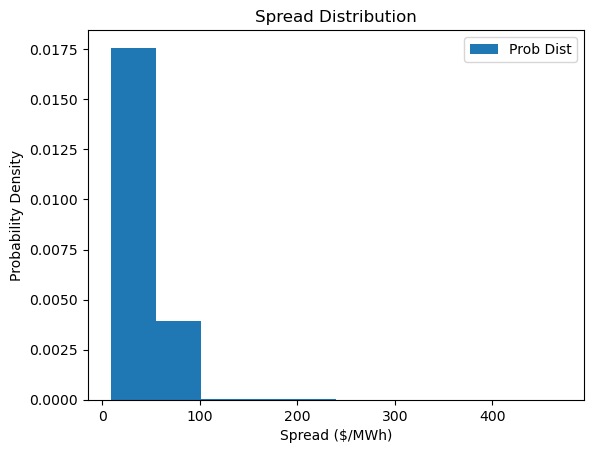

In [19]:
# Measure prediction spread
fig = go.Figure()

def spread_plot(y_pred, label, fig, alpha=1):

    q_hi = 0.95
    q_low = 0.05

    i_low = np.where(quantiles == q_low)[0][0]
    y_pred_low = y_pred[:,i_low]

    i_hi = np.where(quantiles == q_hi)[0][0]
    y_pred_hi = y_pred[:,i_hi]

    spread = y_pred_hi - y_pred_low
    avg_width = spread.mean()
    print(f'Average 5-95% Prediction Width: {avg_width:.{3}} $/MWh')

    fig.add_trace(go.Scatter(x=time, y=spread, mode='lines', name=label+" Spread", 
                            line=dict(width=2), fill=None))


    plt.hist(spread, density=True, label=label, alpha=alpha)

spread_plot(y_pred, model_label, fig)
#spread_plot(y_pred_baseline, "Baseline", fig, alpha=0.5)


fig.add_trace(go.Scatter(x=time, y=y_test + dam, mode='lines', name='RTM Price',
                      line=dict(width=1, color='black', dash='dot')))


start = datetime.fromisoformat('2025-03-01 00:00:00')
end = datetime.fromisoformat('2025-03-08 00:00:00')

fig.update_layout(title='5-95% Spread Measure',
                  xaxis_title='Time',
                  width=1000, 
                  height=500,
                  yaxis_title='Price ($/MWh)',
                  xaxis=dict(range=[start, end]),   
                  yaxis=dict(range=[-100, 250]), 
                 )
fig.show()

plt.xlabel('Spread ($/MWh)')
plt.ylabel('Probability Density')
plt.title("Spread Distribution")
plt.legend()
plt.show()